# Lab 2: Homography estimation and applications

In this lab you will learn how to estimate a homography relating two images given a set of correspondences between them. Then, you will work with different computer vision applications of the homography.

More precisely, the goals are:

1) Homography estimation with the DLT algorithm. <br>

2) Application: Image mosaics. <br>

3) Refinement of the estimated homography with the Gold Standard algorithm. <br>

4) Application: Camera calibration with a planar pattern and augmented reality. <br>

5) Application: Logo detection. <br>

6) Application: Logo replacement.

The following file combines some text cells (Markdown cells) and code cells. Some parts of the code need to be completed. All tasks you need to complete are marked in <span style='color:Green'> green.  </span>

In [48]:
import numpy as np
import cv2
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from utils import apply_H_fixed_image_size, plot_img, Ransac_DLT_homography

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## **1. Homography estimation with the DLT algorithm**

### **1.1 Compute image correspondences**
Execute the following code to find image correspondences using ORB [1] (you may also use SIFT, SURF, etc)

[1] Ethan Rublee, Vincent Rabaud, Kurt Konolige, Gary R. Bradski: ORB: An efficient alternative to SIFT or SURF. ICCV 2011: 2564-2571.

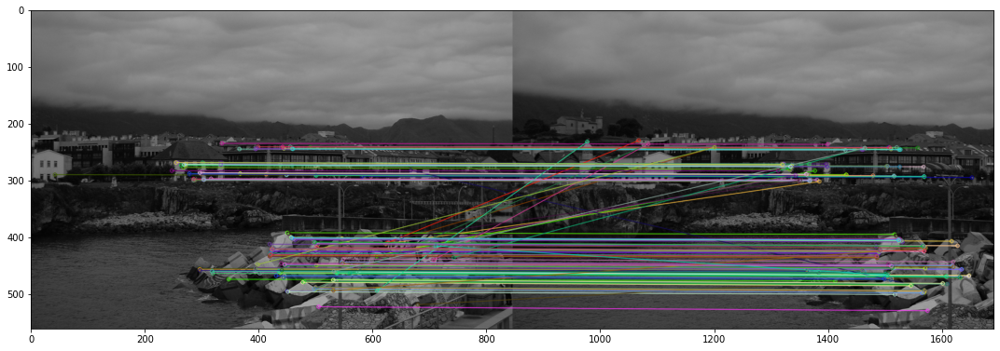

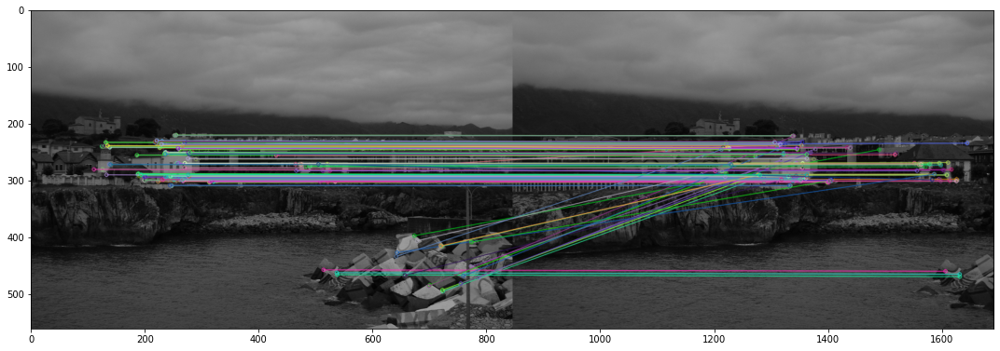

In [156]:
def compute_correspondences(filenames, visualization=True):
    # Read images
    img1 = cv2.imread(filenames[0],cv2.IMREAD_GRAYSCALE)
    img2 = cv2.imread(filenames[1],cv2.IMREAD_GRAYSCALE)
    img3 = cv2.imread(filenames[2],cv2.IMREAD_GRAYSCALE)

    # Initiate ORB detector
    orb = cv2.ORB_create()
    # find the keypoints and descriptors with ORB
    kp1, des1 = orb.detectAndCompute(img1,None)
    kp2, des2 = orb.detectAndCompute(img2,None)
    kp3, des3 = orb.detectAndCompute(img3,None)

    # Keypoint matching
    bf = cv2.BFMatcher()
    matches_12 = bf.knnMatch(des1,des2,k=2)
    # Apply ratio test
    good_matches_12 = []
    for m,n in matches_12:
        if m.distance < 0.85*n.distance:
            good_matches_12.append([m])

    matches_23 = bf.knnMatch(des2,des3,k=2)
    # Apply ratio test
    good_matches_23 = []
    for m,n in matches_23:
        if m.distance < 0.85*n.distance:
            good_matches_23.append([m])

    if visualization == True:
        # Show "good" matches 
        img_12 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_12)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()

        img_23 = cv2.drawMatchesKnn(img2,kp2,img3,kp3,good_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_23)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()
    
    return img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23

img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'])

### **1.2 Compute the homography (DLT algorithm) between image pairs**

The following cell of code calls the 'Ransac_DLT_homography' function from utils.py
Before running the code of the cell you first need to complete some functions in utils.py that are called from 'Ransac_DLT_homography' function:

<span style='color:Green'> - Complete the 'DLT_homography' function that computes a homography from a set of point correspondences with the DLT algorithm.  </span>

<span style='color:Green'> - Complete the 'Inliers' function that, given a homography, a set of point correspondences and a certain threshold  returns the indices of the correspondences that are inliers.  </span>


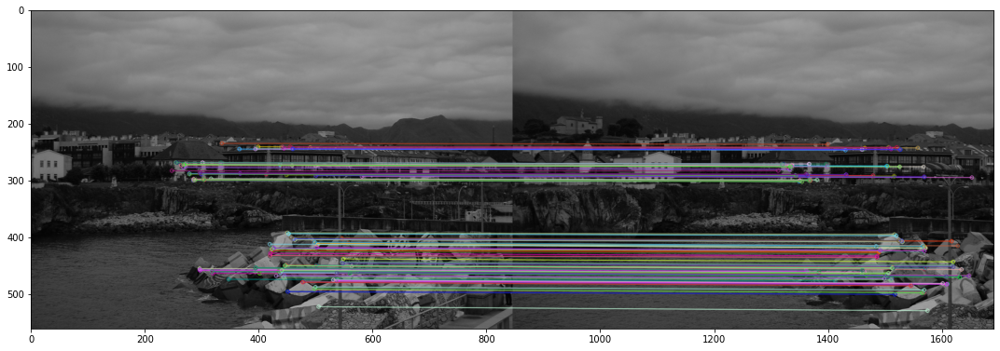

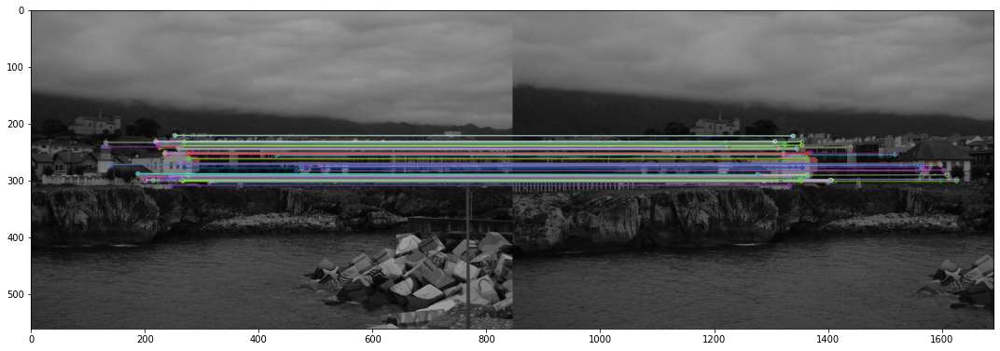

In [157]:

def compute_homography(kp1, kp2, good_matches, img1, img2, visualization=True):
    # Homography between images 1 and 2
    points1 = []
    points2 = []
    for m in good_matches:
        points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1])
        points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1])
        
    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

    H, indices_inlier_matches = Ransac_DLT_homography(points1, points2, 3, 1000)
    inlier_matches = itemgetter(*indices_inlier_matches)(good_matches)

    if visualization == True:
        img_12 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_12)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()
    
    return H, points1, points2, indices_inlier_matches
    
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2)
H_23, points3, points4, indices_inlier_matches_23 = compute_homography(kp2, kp3, good_matches_23, img2, img3)

## **2. Application: Image mosaics**

Now that the homographies relating the images have been estimated we can create a mosaic by properly transforming and fusing the different image contents.
For that we create a big enough canvas where the mosaic will be created. The function 'apply_H_fixed_image_size' is provided in utils.py, it is a variant of the 'apply_H' function from lab 1 where this time the size of the transformed is fixed and given as an extra input.

<span style='color:Green'> - Complete the 2nd input argument to the 'apply_H_fixed_image_size' function in order to get the image mosaic. </span>

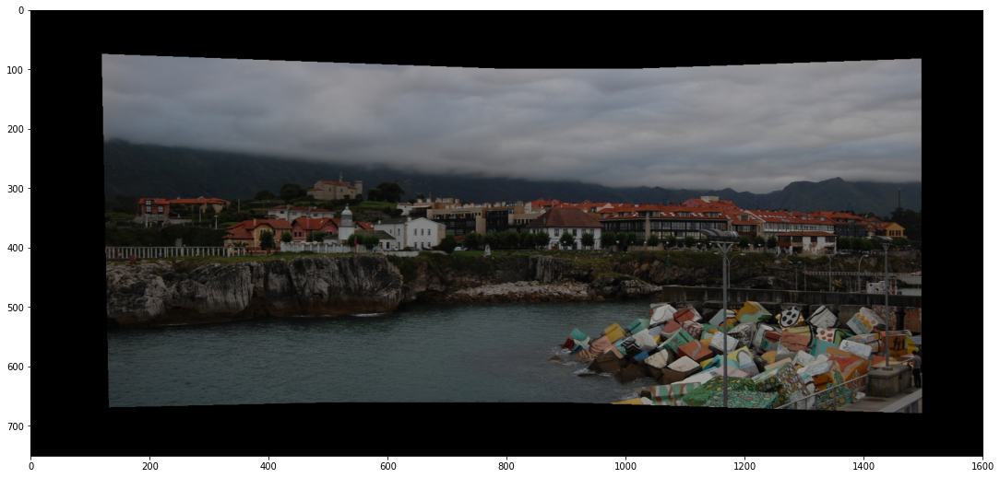

In [158]:
def create_mosaic(H_12, H_23, input_filenames, result_filename, corners = [-400, 1200, -100, 650], visualization=True):
    corners = corners # corners of the canvas where the mosaic will be created

    img1c = cv2.imread(input_filenames[0],cv2.IMREAD_COLOR)
    img2c = cv2.imread(input_filenames[1],cv2.IMREAD_COLOR)
    img3c = cv2.imread(input_filenames[2],cv2.IMREAD_COLOR)
    img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
    img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
    img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)


    img1c_w = apply_H_fixed_image_size(img1c, H_12, corners) # complete the call to the function
    img2c_w = apply_H_fixed_image_size(img2c, np.identity(3), corners) # complete the call to the function
    img3c_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners) # complete the call to the function

    if visualization == True:
        img_mosaic = np.maximum(img3c_w,np.maximum(img1c_w,img2c_w))
        plot_img(img_mosaic)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
        cv2.imwrite(result_filename, img_mosaic) 
    
    return img1c, img2c, img3c
    
img1c, img2c, img3c = create_mosaic(H_12, H_23, ['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'], 'mosaic_llanes.png')

<span style='color:Green'> - Compute the mosaic with castle_int images. </span>

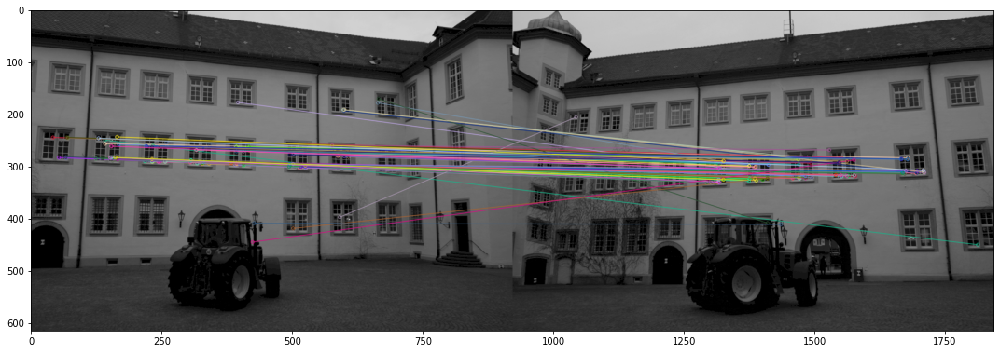

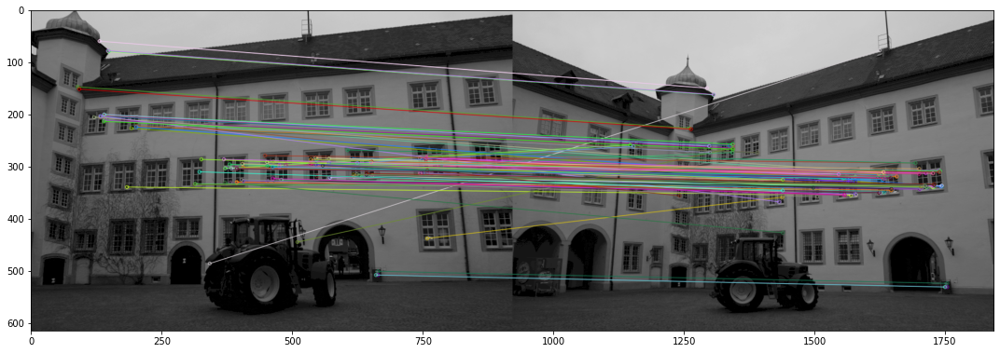

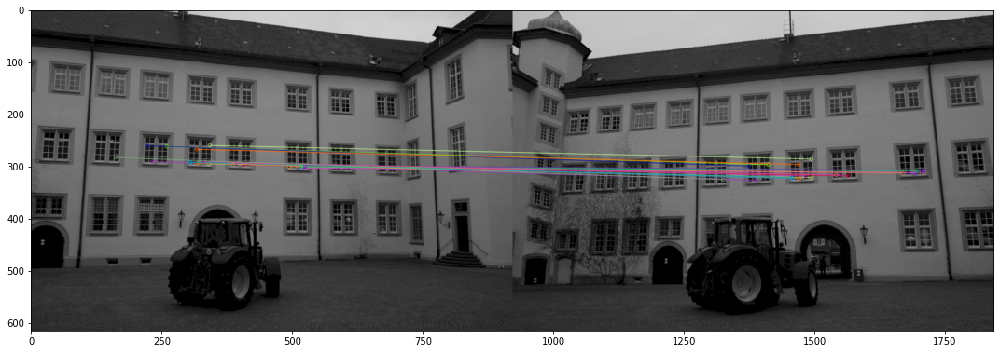

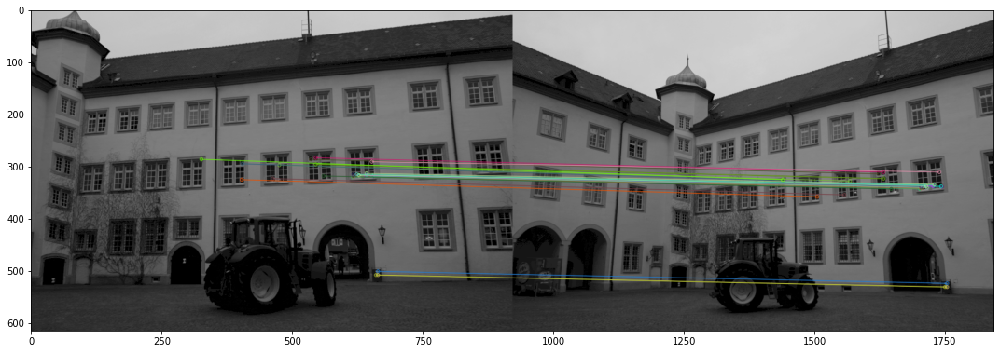

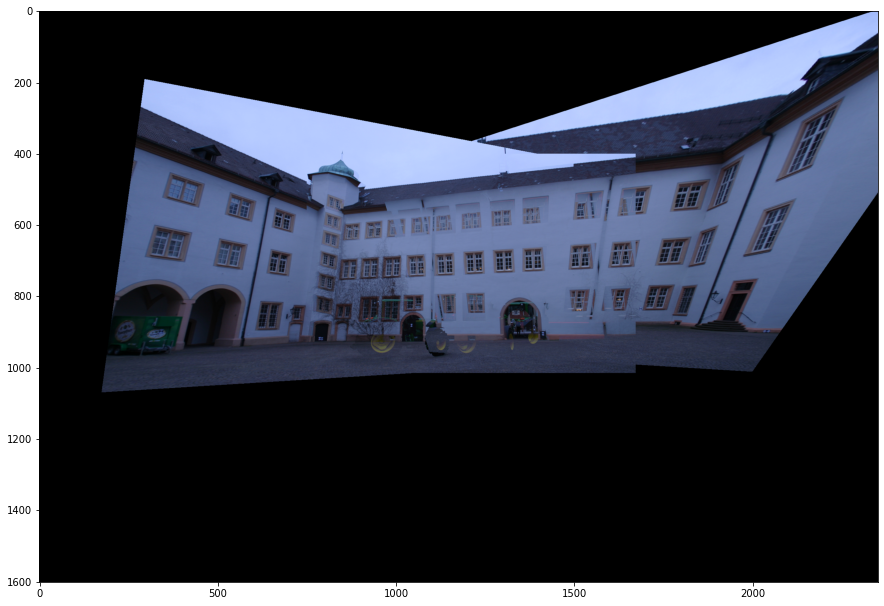

In [159]:
input_filenames = ['Data/castle_int/0014_s.png', 'Data/castle_int/0015_s.png', 'Data/castle_int/0016_s.png']
img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(input_filenames)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2)
H_23, points3, points4, indices_inlier_matches_23  = compute_homography(kp2, kp3, good_matches_23, img2, img3)
img1c, img2c, img3c = create_mosaic(H_12, H_23, input_filenames, 'mosaic_castle_int.png', [-750, 1600, -400, 1200])

<span style='color:Green'> - Compute the mosaic with aerial images set 13 </span>

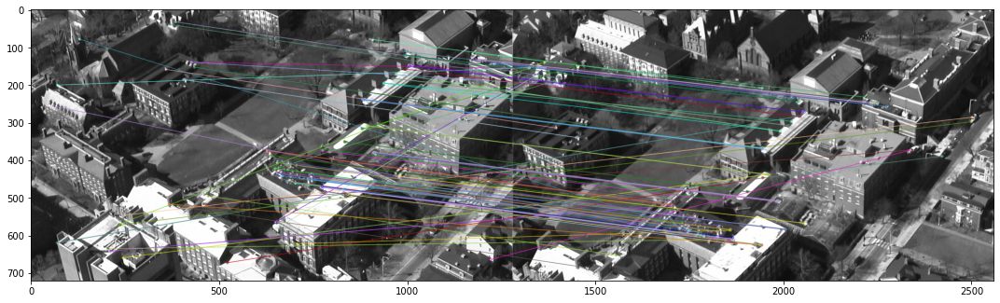

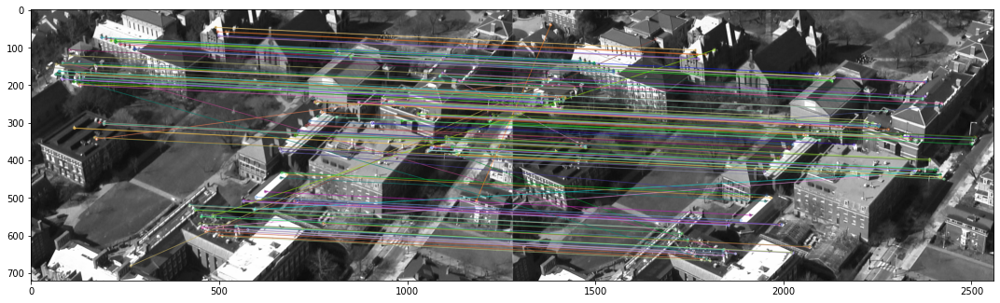

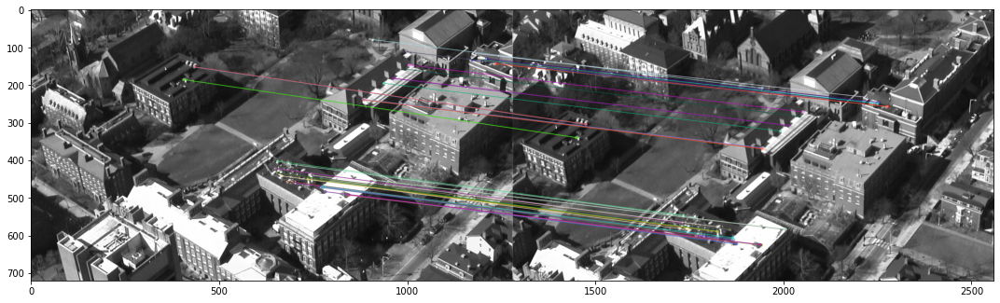

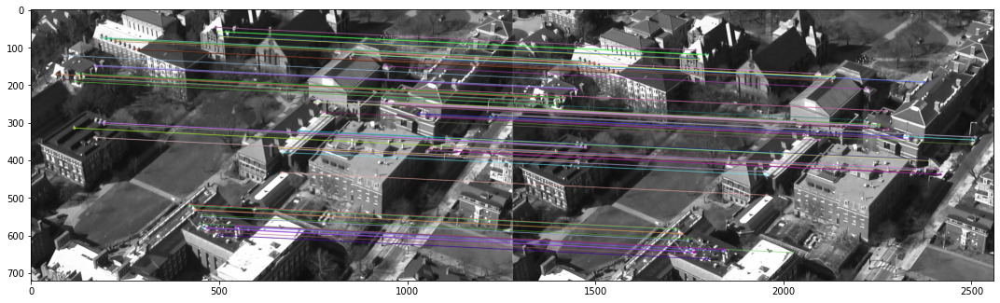

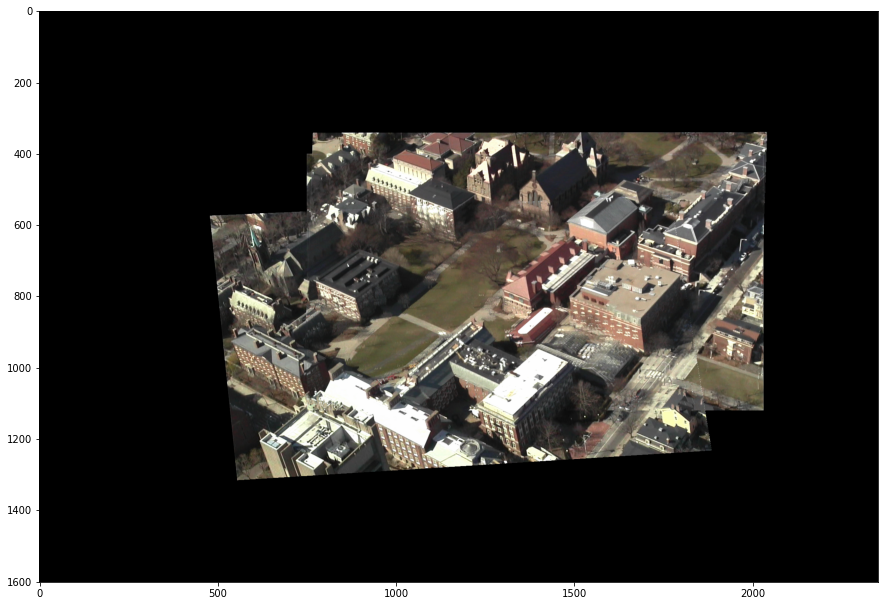

In [160]:
input_filenames = ['Data/aerial/site13/frame00000.png', 'Data/aerial/site13/frame00002.png', 'Data/aerial/site13/frame00003.png']
img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(input_filenames)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2)
H_23, points3, points4, indices_inlier_matches_23  = compute_homography(kp2, kp3, good_matches_23, img2, img3)
img1c, img2c, img3c = create_mosaic(H_12, H_23, input_filenames, 'mosaic_aerial_set13.png', [-750, 1600, -400, 1200])


<span style='color:Green'> - Compute the mosaic with aerial images set 22 </span>

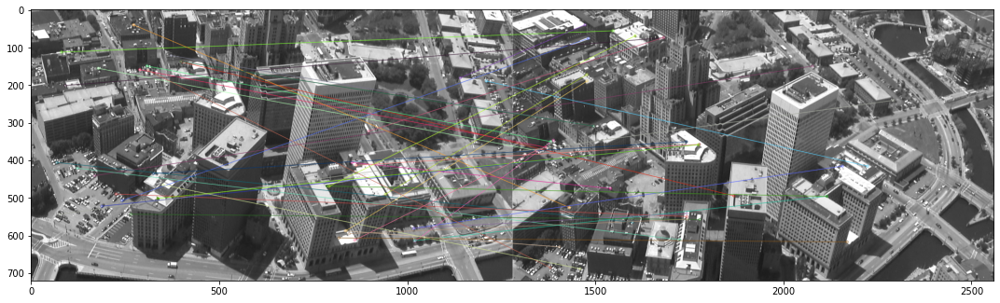

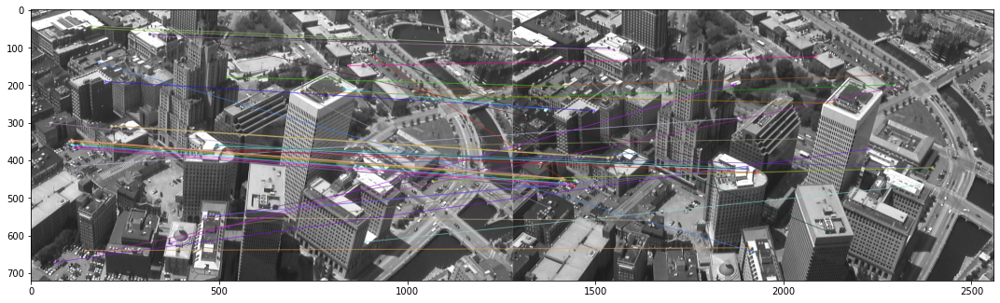

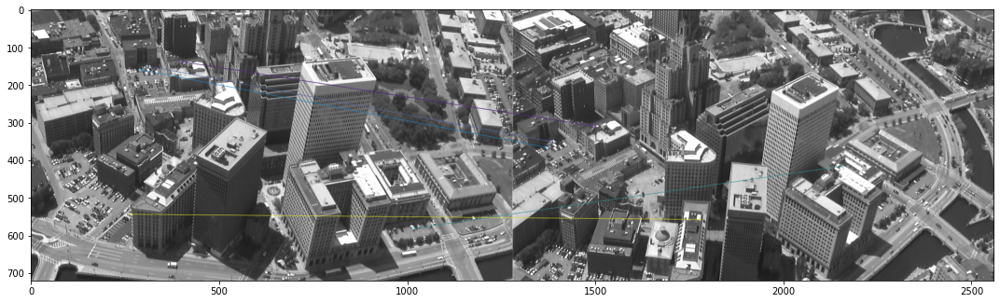

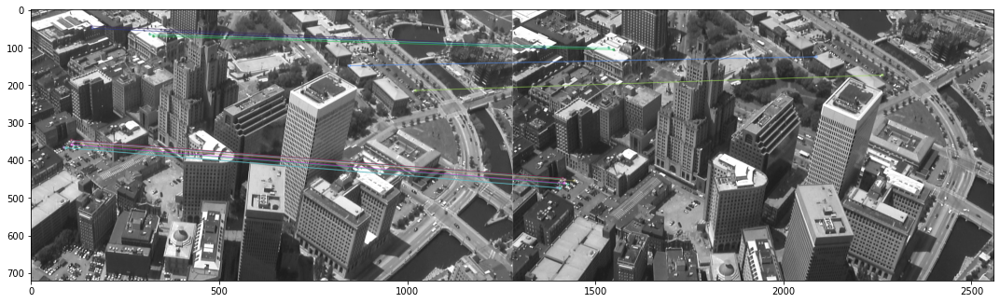

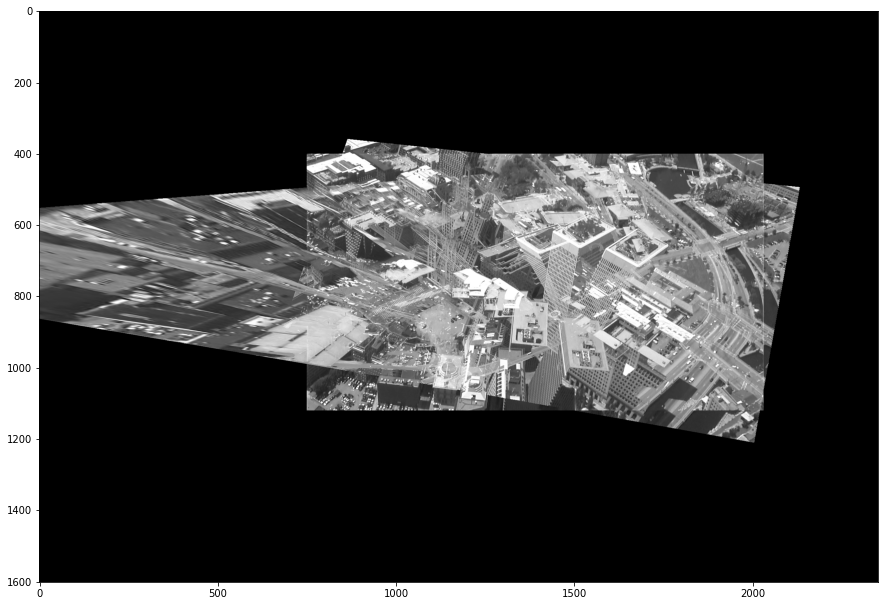

In [161]:
input_filenames = ['Data/aerial/site22/frame_00001.tif', 'Data/aerial/site22/frame_00018.tif', 'Data/aerial/site22/frame_00030.tif']
img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(input_filenames)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2)
H_23, points3, points4, indices_inlier_matches_23  = compute_homography(kp2, kp3, good_matches_23, img2, img3)
img1c, img2c, img3c = create_mosaic(H_12, H_23, input_filenames, 'mosaic_aerial_set22.png', [-750, 1600, -400, 1200])

## **3. Refinement of the estimated homography with the Gold Standard algorithm**

In order to refine the previous estimated homography we can minimize the geometric error with the Levenberg-Marquardt algorithm. For that we will call the function 'least_squares' with the proper input arguments that you have to complete. First, it is recommended to read the documentation of that function:

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

Notice that the first input is a function that only provides the vector of the residuals. The algorithm constructs the cost function as a sum of squares of the residuals. In our case the function is called 'geometric_error_terms' and you need to complete it.

More precisely, the tasks to perform are:

<span style='color:Green'> - Complete the function 'geometric_error_terms'. </span>

<span style='color:Green'> - Complete the code before calling function 'geometric_error_terms' in order to create the proper input of variables, 'variables0', to pass to the function. </span>

<span style='color:Green'> - Extract the refined homography and the refined keypoint locations from the output, 'result', of function 'geometric_error_terms'.  </span>

<span style='color:Green'> - To better compare the two homographies (refined and non refined) compute and print the geometric error before and after the refinement. </span>

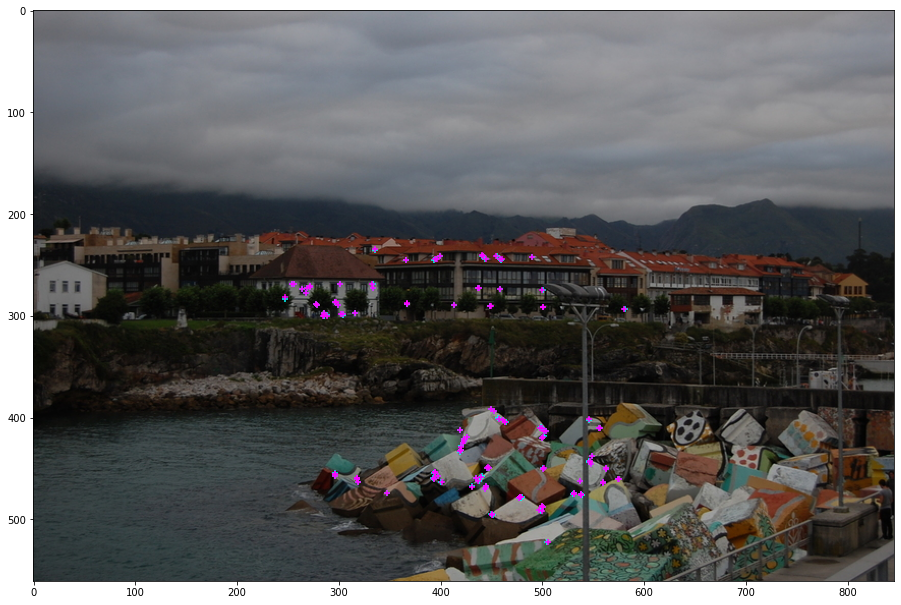

Initial square error: 589968977.4623
Final square error: 27.1536


In [162]:
from scipy.optimize import least_squares
from math import ceil

def geometric_error_terms(variables, data_points):    
    H_12 = variables[:9].reshape(3,3)
    points1_hat = variables[9:].reshape(2,-1)
    
    points1, points2 = data_points
    points2_hat = H_12 @ np.vstack((points1_hat, np.ones(points1_hat.shape[1])))
    
    points2_hat = points2_hat[0:2,:] / points2_hat[2, :]
    
    # We should minimize the Symmetric Transfer Error
    res_vector = np.hstack(((points1-points1_hat).ravel(), (points2-points2_hat).ravel()))
    
    # The LM algorithm performs sum of squares of the residual vector and tries to minimize that value
    return res_vector

def geometric_minimization(points1, points2, H_12, indices_inlier_matches_12):
    # We minimize over the point inliers given by RANSAC
    points1_inliers = points1[:2, indices_inlier_matches_12] 
    points2_inliers = points2[:2, indices_inlier_matches_12] 

    # Compute an initial estimate of the subsidiary variables {x_hat_i} using the measured points {x_i'}
    points1_inliers_hat = np.linalg.inv(H_12) @ np.vstack((points2_inliers, np.ones(points2_inliers.shape[1]))) 

    # The cost should be minimized using the Levenberg-Marquardt algorithm over 2n+9 variables:
    # 2n for the n 2D points x_hat_i and 9 for the homography matrix H_hat
    # The initial vector to improve should be given on the Levenberg-Marquardt algorithm
    variables0 = np.hstack((H_12.ravel(), points1_inliers_hat[0:2,:].ravel()))

    result = least_squares(geometric_error_terms, variables0, method='lm', args=([[points1_inliers, points2_inliers]]))
    
    initial_square_error = np.sum(np.square(geometric_error_terms(variables0, [points1_inliers, points2_inliers])))
    final_square_error = result.cost
    
    return points1_inliers, points2_inliers, result, initial_square_error, final_square_error

def refine_points(points1, points2, H_12, indices_inlier_matches_12, img1c, visualization=True):
    # Obtain the solution and show points
    points1_inliers, points2_inliers, result, initial_square_error, final_square_error = geometric_minimization(points1, points2, H_12, indices_inlier_matches_12)
    solution = result.x
    H_12_r = solution[:9].reshape(3,3)
    points1r = solution[9:].reshape(2,-1)

    if visualization == True:
        fig, ax = plt.subplots()
        ax.imshow(img1c)
        ax.scatter(points1_inliers[0,:],points1_inliers[1,:], c='cyan', marker='+')
        ax.scatter(points1r[0,:],points1r[1,:], c='fuchsia', marker='+')
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()

        # Show initial and final square errors
        print('Initial square error: %.4f' %(initial_square_error))
        print('Final square error: %.4f' %(result.cost))
    
    return H_12_r, points1_inliers, points1r

img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'],
                                                                                            visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
H_23, points3, points4, indices_inlier_matches_23 = compute_homography(kp2, kp3, good_matches_23, img2, img3, visualization=False)
img1c, img2c, img3c = create_mosaic(H_12, H_23, ['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'], 'mosaic_llanes.png', visualization=False)

# We refine the points printing initial and final square errors and differences in original and resulting refined image keypoints
H_12_r, points1_inliers, points1r = refine_points(points1, points2, H_12, indices_inlier_matches_12, img1c)

<span style='color:Green'> - Refine the homography 23 with the Gold Standard algorithm and visualize the differences in the keypoint locations. </span>

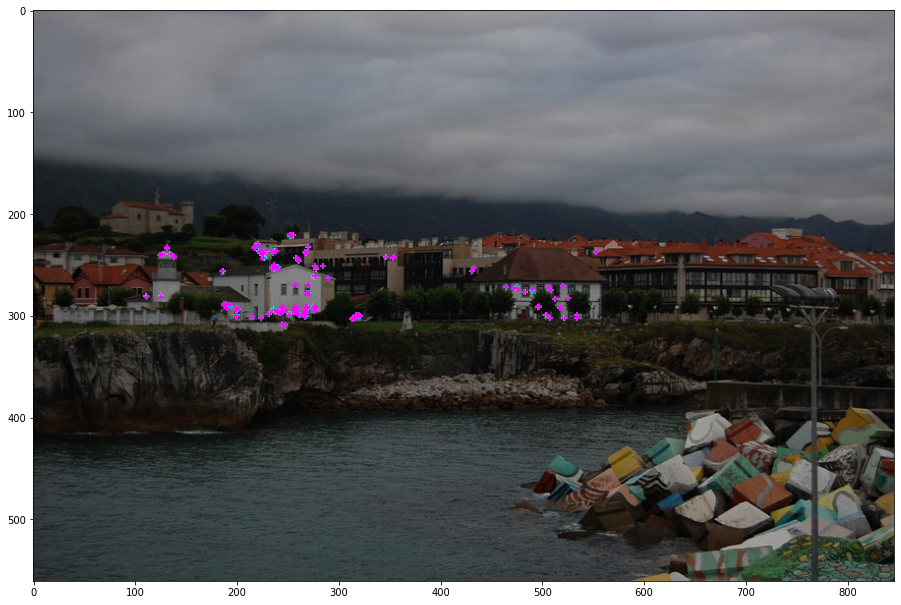

Initial square error: 28417156.8748
Final square error: 38.7184


In [163]:
img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'],
                                                                                            visualization=False)
H_23, points3, points4, indices_inlier_matches_23 = compute_homography(kp2, kp3, good_matches_23, img2, img3, visualization=False)
img1c, img2c, img3c = create_mosaic(H_12, H_23, ['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'], 'mosaic_llanes.png',visualization=False)

H_23_r, points2_inliers, points2r = refine_points(points3, points4, H_23, indices_inlier_matches_23, img2c)

<span style='color:Green'> - Build mosaic with the refined homographies. </span>

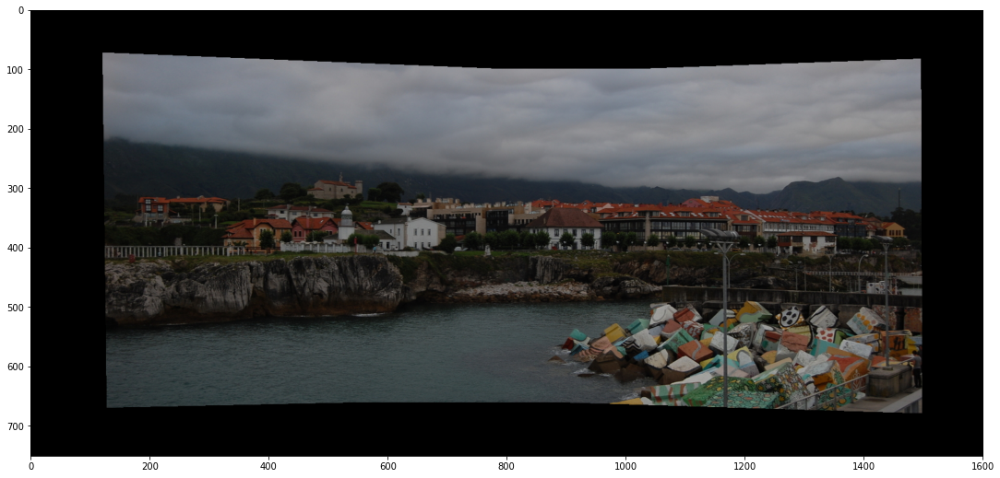

In [164]:
img1c, img2c, img3c = create_mosaic(H_12_r, H_23_r, ['Data/llanes/llanes_a.jpg', 'Data/llanes/llanes_b.jpg', 'Data/llanes/llanes_c.jpg'], 'mosaic_llanes.png')

## Refinement with caste_int

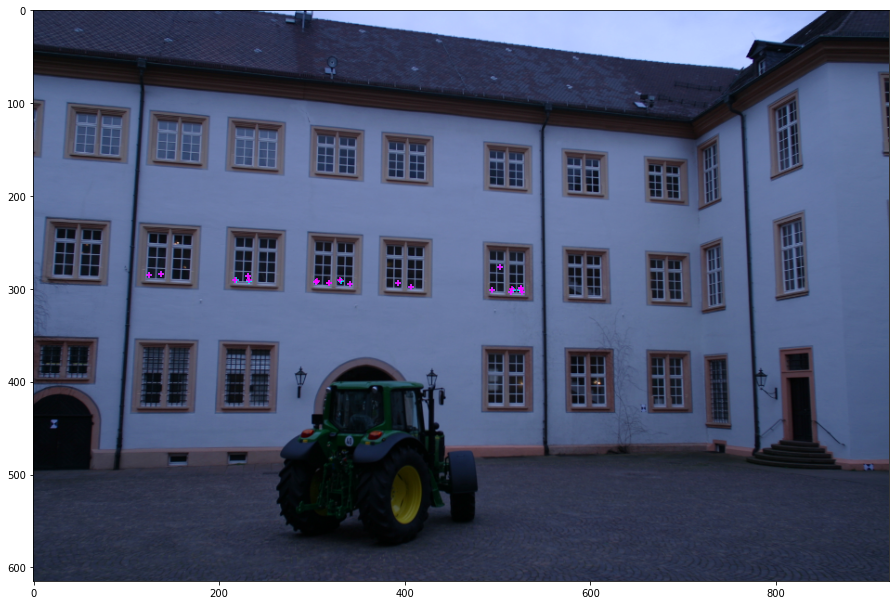

Initial square error: 5449363.6699
Final square error: 3.8181


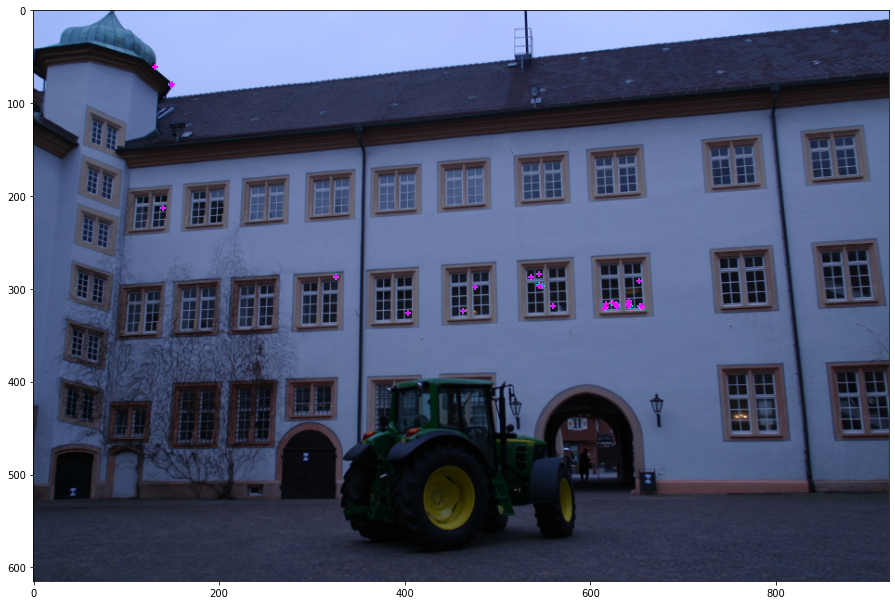

Initial square error: 26998259.6197
Final square error: 3.8217


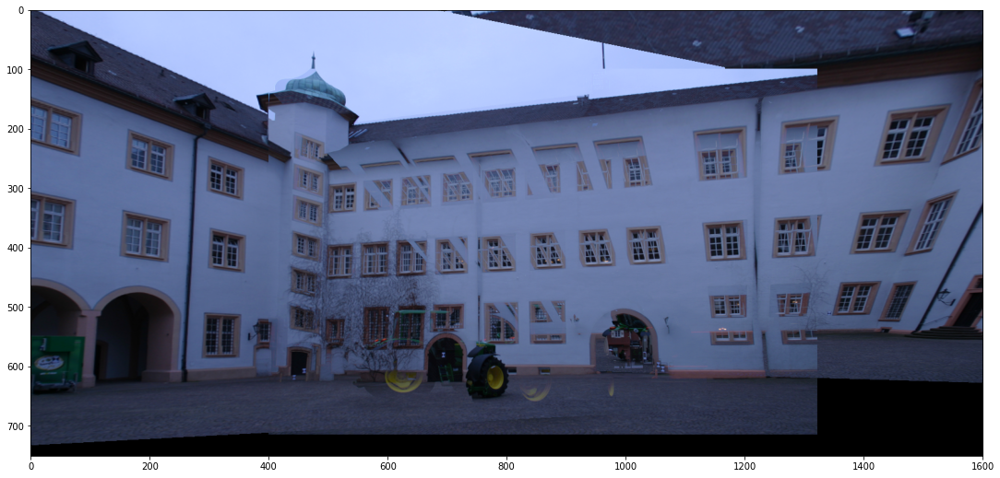

In [165]:
input_filenames = ['Data/castle_int/0014_s.png', 'Data/castle_int/0015_s.png', 'Data/castle_int/0016_s.png']
img1, img2, img3, kp1, kp2, kp3, good_matches_12, good_matches_23 = compute_correspondences(input_filenames,
                                                                                            visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
H_23, points3, points4, indices_inlier_matches_23 = compute_homography(kp2, kp3, good_matches_23, img2, img3, visualization=False)
img1c, img2c, img3c = create_mosaic(H_12, H_23, input_filenames, 'mosaic_castle_int.png', visualization=False)

H_12_r, points1_inliers, points1r = refine_points(points1, points2, H_12, indices_inlier_matches_12, img1c)
H_23_r, points2_inliers, points2r = refine_points(points3, points4, H_23, indices_inlier_matches_23, img2c)

img1c, img2c, img3c = create_mosaic(H_12_r, H_23_r, input_filenames, 'mosaic_castle_int.png')

## **4. OPTIONAL. Application: Calibration with a planar pattern and augmented reality**

As we have seen in class, we can calibrate a camera with a planar pattern with Zhang's algorithm. A key aspect of this algorithm is the estimation of a homography that relates a pair of images, in particular, the template image and an image of it taken with the camera we want to calibrate. Once the camera is calibrated and we have recovered the relative pose between the camera and the planar pattern we can properly insert a virtual object on top of the flat pattern in a way that it is consistent, in a perspective sense, with rest of the scene.

### **4.1 Camera calibration**

The following code calibrates a camera using N (where N greater or equal than three) views of the planar pattern. Most of the code is provided but there are parts you need to complete. These parts are indicated in green before the corresponding cell code.


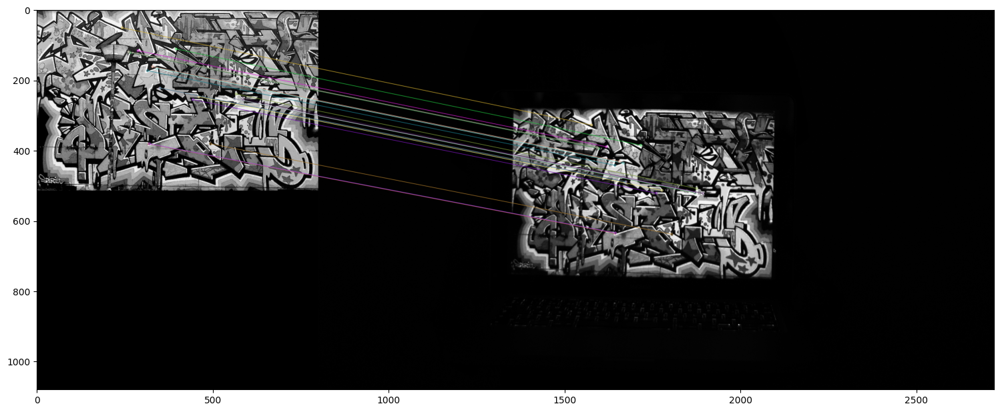

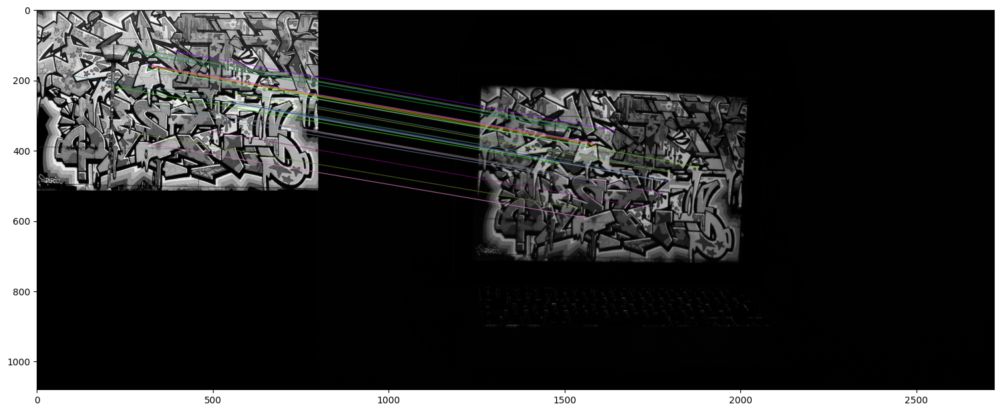

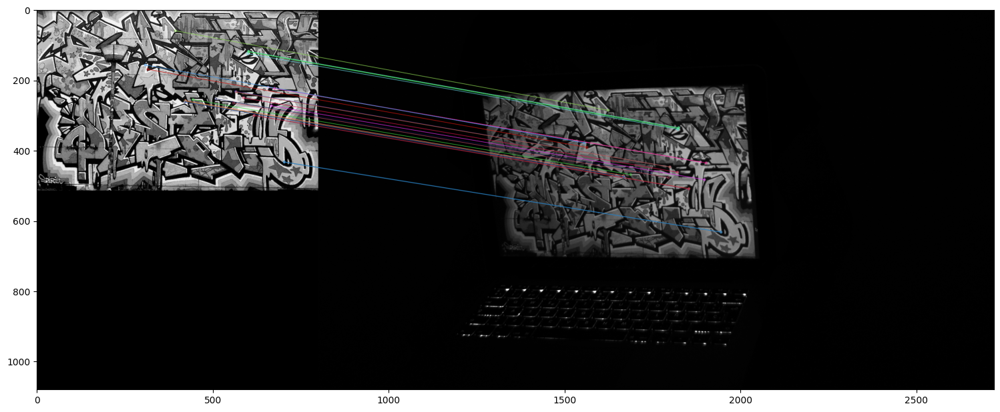

In [49]:
# Read template image and calibration images
template = cv2.imread('Data/calib/template.jpg',cv2.IMREAD_GRAYSCALE)
images = []
N = 3 # 3, 4, or 5
for i in range(1,N+1):
    m = cv2.imread("Data/calib/graffiti{0}.tif".format(i),cv2.IMREAD_GRAYSCALE)
    images.append(m)

# Initiate ORB detector
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kpt, dest = orb.detectAndCompute(template,None)
kpi, desi = [], []
for m in images:
    kp, des = orb.detectAndCompute(m,None)
    kpi.append(kp)
    desi.append(des)


# Keypoint matching and homography estimation
bf = cv2.BFMatcher()
H = []
for i in range(N):
    matches = bf.knnMatch(dest,desi[i],k=2)
    # Apply ratio test
    good_matches = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good_matches.append([m])
    
    # Fit homography and remove outliers
    points1 = []
    points2 = []
    for m in good_matches:
        points1.append([kpt[m[0].queryIdx].pt[0], kpt[m[0].queryIdx].pt[1], 1])
        points2.append([kpi[i][m[0].trainIdx].pt[0], kpi[i][m[0].trainIdx].pt[1], 1])
    
    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T
    
    Hi, indices_inlier_matches = Ransac_DLT_homography(points1, points2, 3, 1000)
    H.append(Hi)
    
    # Show inlier matches
    inlier_matches = itemgetter(*indices_inlier_matches)(good_matches)
    img_12 = cv2.drawMatchesKnn(template,kpt,images[i],kpi[i],inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    


<span style='color:Green'> - Complete the code that computes the Image of the Absolute Conic. </span>

<span style='color:Green'> - Complete the code that computes the matrix of internak parameters, K. </span>

Note: there is a linalg.cholesky function both in numpy and scipy, you have to read the documentation of both and find out which is the proper one to use here.

<span style='color:Green'> - In the report, make some comments related to the obtained internal camera parameters and also comment their relation to the image size. </span>

In [50]:
import scipy

# Compute the Image of the Absolute Conic ...
def compute_iac(omega):
    #check theory
    return np.array([[omega[0], omega[1], omega[2]],[omega[1], omega[3], omega[4]],[omega[2], omega[4], omega[5]]])

# Compute the matrix of internal parameters, K ...
def compute_K(H, N):
    
    #create matrix V
    
    #two equations V12T*omega = 0 and (V11T - V22T)*omega = 0 -> we have to solve V2nx6*Omega = 0
    #  VijT =(h1i h1j, h1i h2j + h2i h1j, h1ih3j + h3i h1j, h2ih2j, h2ih3j + h3i h2j, h3ih3j)
    V = np.empty(shape=(2*N, 6))
    for i in range(N):
        Hi = H[i]
        
        h1 = Hi[:, 0]
        h2 = Hi[:, 1]
        h3 = Hi[:, 2]
            
        V12 = np.array([h1[0]*h2[0], h1[0]*h2[1] + h1[1]*h2[0], h1[0]*h2[2] + h1[2]*h2[0], h1[1]*h2[1], h1[1]*h2[2] + h1[2]*h2[1], h1[2]*h2[2]])
        V11 = np.array([h1[0]*h1[0], h1[0]*h1[1] + h1[1]*h1[0], h1[0]*h1[2] + h1[2]*h1[0], h1[1]*h1[1], h1[1]*h1[2] + h1[2]*h1[1], h1[2]*h1[2]])
        V22 = np.array([h2[0]*h2[0], h2[0]*h2[1] + h2[1]*h2[0], h2[0]*h2[2] + h2[2]*h2[0], h2[1]*h2[1], h2[1]*h2[2] + h2[2]*h2[1], h2[2]*h2[2]])
        
        V[2*i, :] = V12
        V[2*i + 1, :] = (V11 - V22)
    
  
    #V = UDU^T
    U,D,UT = np.linalg.svd(V)
    
    #omega is the Ω is the singular vector associated to the smallest singular  (last column of U¯, where V SVD UDU¯T )
    omega = UT.T[:,-1]
    
    w = compute_iac(omega)
    
    # w = K^(-t)*K^(-1)
    Kinv = scipy.linalg.cholesky(w)
    K = np.linalg.inv(Kinv)
    
    
    return K, Kinv



K, Kinv = compute_K(H, N)
print(K)

[[ 2.98774987e+03 -3.08015829e+01  8.64247336e+02]
 [ 0.00000000e+00  2.99966176e+03  6.28407681e+02]
 [ 0.00000000e+00  0.00000000e+00  1.06245697e+00]]


<span style='color:Green'> - Complete the calculation of r1, r2, and ti in the code below. </span>

In [51]:
# Compute camera position and orientation
import math
R = []
t = []
P = []

for i in range(N):
    # compute r1, r2, and t{i}
    h = H[i]
    r1 = Kinv @ h[:,0] # complete ...
    r2 = Kinv @ h[:, 1] # complete ...
    ti = Kinv @ h[:, 2] # complete ...
    
    # Solve the scale ambiguity by forcing r1 and r2 to be unit vectors.
    s = math.sqrt(np.linalg.norm(r1) * np.linalg.norm(r2)) * np.sign(ti[2])
    r1 = r1 / s
    r2 = r2 / s
    ti = ti / s
    t.append(ti)
    Ri = np.array([r1, r2, np.cross(r1,r2)])
    Ri = Ri.T
    
    # Ensure R is a rotation matrix
    U, d, Vt = np.linalg.svd(Ri)
    Ri = U @ np.identity(3) @ Vt
    R.append(Ri)
   
    # Pi = K * [Ri ti]
    A = np.zeros((3,4))
    A[:3,:3] = Ri
    A[:,3] = ti
    Pi = K @ A
    P.append(Pi)

The following code (no need to be completed) draws the planar pattern and the N camera locations (position and orientation).

<span style='color:Green'> - Take a look to the provided code for that and in the report explain how the optical center is computed. </span>

In [52]:
import plotly.graph_objects as go
from utils import plot_camera, plot_image_origin

ny, nx = images[0].shape

fig = go.Figure()
for i in range(N):
    plot_camera(P[i], nx, ny, fig, "camera{0}".format(i))

plot_image_origin(nx, ny, fig, "image")

fig.show()

Alternatively, we can draw a fixed camera and N planar patterns at different relative poses with respect to the camera.

<span style='color:Green'> -Complete the function ' plot_image_Rt' in order to achieve that. Note: it may be useful to look at function 'plot_image_origin' in utils.py</span>

In [53]:
def plot_image_Rt(R,t,w, h, fig, legend):
    Rt = np.column_stack([R, t])
    p1 = Rt @ np.array([0, 0, 0, 1])
    p2 = Rt @ np.array([w, 0, 0, 1])
    p3 = Rt @ np.array([w, h, 0, 1])
    p4 = Rt @ np.array([0, h, 0, 1])

    x = np.array([p1[0], p2[0], p3[0], p4[0], p1[0]])
    y = np.array([p1[1], p2[1], p3[1], p4[1], p1[1]])
    z = np.array([p1[2], p2[2], p3[2], p4[2], p1[2]])

    fig.add_trace(go.Scatter3d(x=x, y=z, z=-y, mode='lines',name=legend))
    
    return


fig = go.Figure()
A = np.zeros((3,4))
A[0,0]=A[1,1]=A[2,2]=1

plot_camera(K@A, nx, ny, fig, "camera")
for i in range(N):
    plot_image_Rt(R[i], t[i], nx, ny, fig, "image{0}".format(i))

fig.show()

### **4.2 Augmented reality**

The following code (no need to be completed) draws a simple 3D virtual object (a cube) on top of the flat pattern.

<span style='color:Green'> - Analyse the provided code and in the report explain how the virtual object is inserted in the image and why the camera view needs to be calibrated. </span>

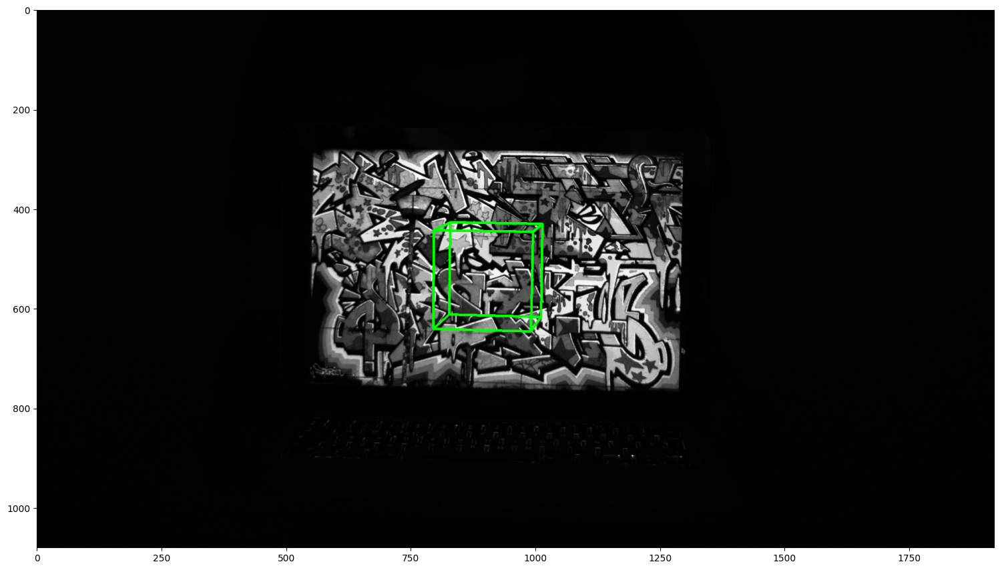

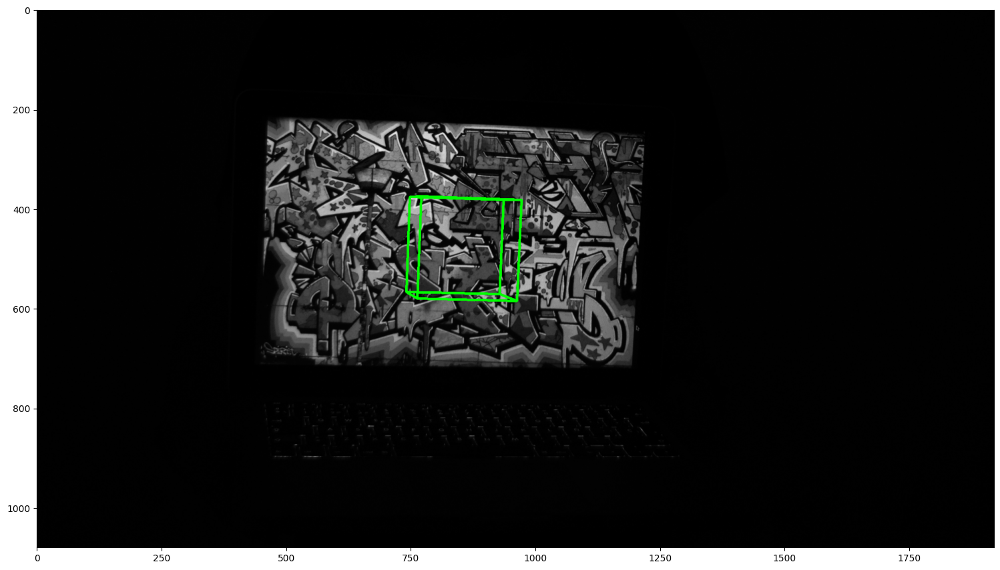

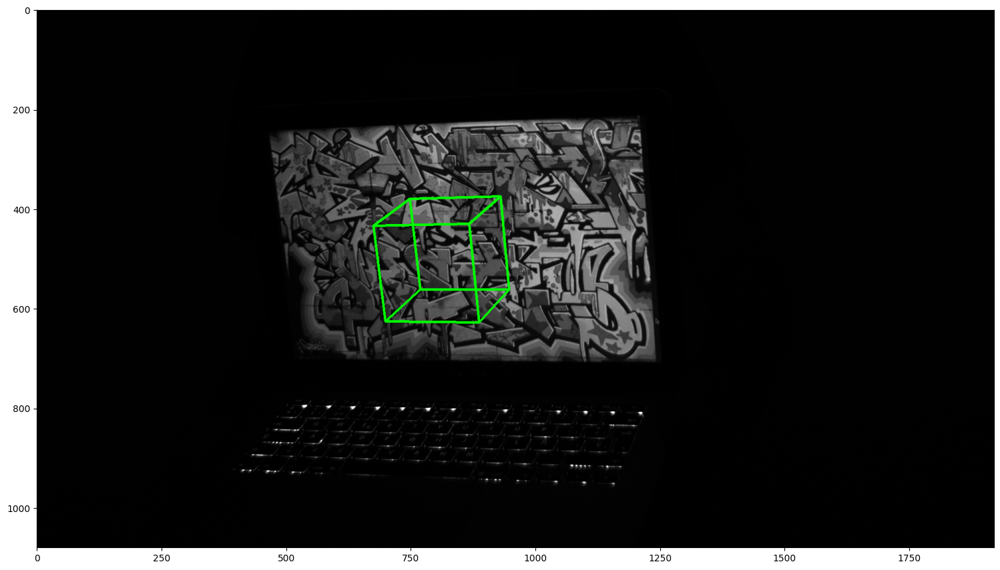

In [54]:
Th, Tw = template.shape
cube_corners = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0], [0, 0, 0], [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], [0, 0, 1], [0, 0, 0], [1, 0, 0], [1, 0, 1], [0, 0, 1], [0, 0, 0], [0, 1, 0], [1, 1, 0], [1, 1, 1], [0, 1, 1], [0, 1, 0]])

import numpy.matlib
offset = np.array([Tw/2, Th/2, -Tw/8])
M = cube_corners.shape[0]
X = (cube_corners - 0.5) * Tw/ 4 + np.matlib.repmat(offset, M, 1)

X = X.T
ones = np.ones(M)
Xh = np.stack((X[0,:], X[1,:], X[2,:], ones), axis=0)

line_color = (0, 255, 0)

for i in range(N):
    
    xp = P[i]@Xh
    xp = xp / xp[2,:]
    xp = xp.astype(int)
    
    image = cv2.imread("Data/calib/graffiti{0}.tif".format(i+1),cv2.IMREAD_COLOR)
    image_gray = image
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_gray[:, :, 0] = gray[:, :]
    image_gray[:, :, 1] = image_gray[:, :, 0]
    image_gray[:, :, 2] = image_gray[:, :, 0]
    for j in range(M-1):
        image = cv2.line(image_gray, (xp[0,j],xp[1,j]), (xp[0,j+1],xp[1,j+1]), line_color, 4) 
    plt.imshow(image)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


## **5. OPTIONAL. Application: Logo detection**

<span style='color:Green'> - Detect the UPF logo in the two UPF images using the DLT algorithm (folder "logos").
Interpret and comment the results. </span>

In [318]:

def compute_correspondences_logo(filename_logo, filename_target, detector='ORB', visualization=True):
    # Read images
    img_logo_color = cv2.imread(filename_logo)
    img_logo = cv2.imread(filename_logo,cv2.IMREAD_GRAYSCALE)
    img_target_color = cv2.imread(filename_target)
    img_target = cv2.imread(filename_target,cv2.IMREAD_GRAYSCALE)
    
    # Initiate ORB detector
    if detector == 'ORB':
        orb = cv2.ORB_create()
    elif detector == 'SIFT':
        orb = cv2.SIFT_create()
    # find the keypoints and descriptors with ORB
    kp1, des1 = orb.detectAndCompute(img_logo,None)
    kp2, des2 = orb.detectAndCompute(img_target,None)

    # Keypoint matching
    bf = cv2.BFMatcher()
    matches_12 = bf.knnMatch(des1,des2,k=2)
    # Apply ratio test
    good_matches_12 = []
    for m,n in matches_12:
        if m.distance < 0.85*n.distance:
            good_matches_12.append([m])


    if visualization == True:
        # Show "good" matches 
        img_12 = cv2.drawMatchesKnn(img_logo,kp1,img_target,kp2,good_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_12)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()
    
    return img_logo, img_logo_color, img_target, img_target_color, kp1, kp2, good_matches_12

def detect_logo(img1, img2, visualization=True):
    h, w = img1.shape[:2]
        
    c1 = np.array([1, 1, 1])
    c2 = np.array([w, 1, 1])
    c3 = np.array([1, h, 1])
    c4 = np.array([w, h, 1])

    Hc1 = H_12 @ c1
    Hc2 = H_12 @ c2
    Hc3 = H_12 @ c3
    Hc4 = H_12 @ c4
    Hc1 = Hc1 / Hc1[2]
    Hc2 = Hc2 / Hc2[2]
    Hc3 = Hc3 / Hc3[2]
    Hc4 = Hc4 / Hc4[2]

    box = np.int0(np.array([[Hc1[0], Hc1[1]],
                [Hc3[0], Hc3[1]],
                [Hc4[0], Hc4[1]],
                [Hc2[0], Hc2[1]]]))

    if visualization==True:
        img2_copy = img2.copy()
        cv2.drawContours(img2_copy, [box], 0, (0, 255, 0), 2)

        plt.figure(figsize=(12,6))
        plt.imshow(cv2.cvtColor(img2_copy,cv2.COLOR_BGR2RGB))
        plt.show()
        
    return Hc1, Hc2, Hc3, Hc4

Using ORB detector we can correctly detect the logo, because we have enough and correct features

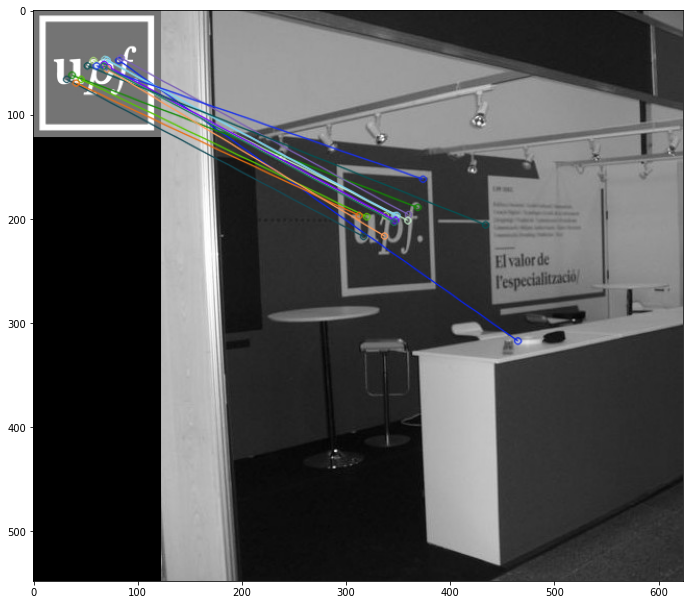

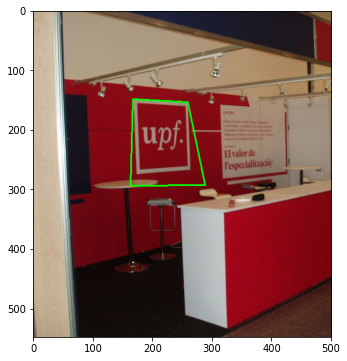

In [291]:
img1, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFstand.jpg', detector='ORB', visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
detect_logo(img1, img2_color)
pass

Using SIFT detector we can still correctly detect the logo

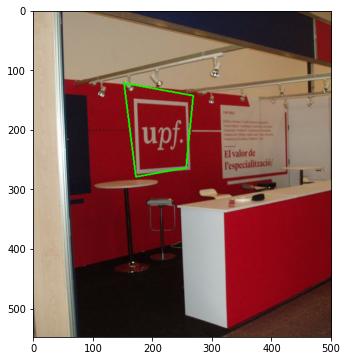

In [290]:
img1, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFstand.jpg', detector='SIFT', visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
detect_logo(img1, img2_color)
pass

Using ORB for the UPF building image, we don't have enough features to relate both images logo, so the logo is not correctly detected

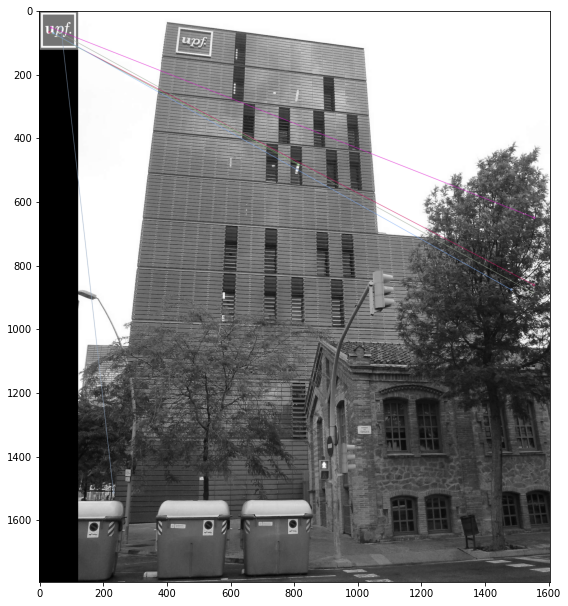

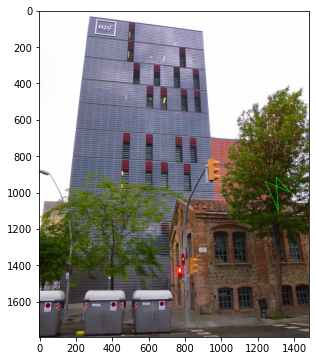

In [349]:
img1, img_logo_color, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFBuilding.jpg', 
                                                                                                 detector='ORB', visualization=True)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
detect_logo(img1, img2_color)
pass

By contrast, SIFT performs best in most scenarios. For instance in the UPF building image the logo keypoints are correctly detected

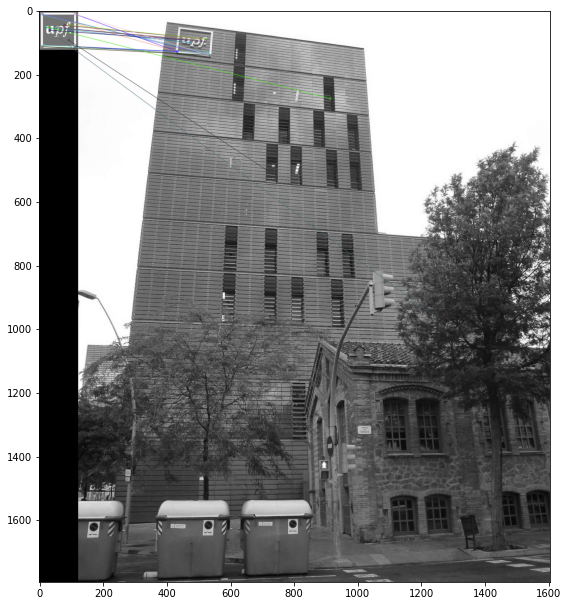

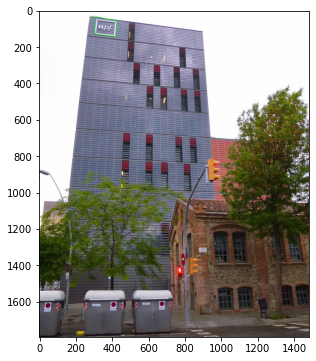

In [353]:
img1, img_logo_color, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFBuilding.jpg',
                                                                                                 detector='SIFT', visualization=True)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
Hc1, Hc2, Hc3, Hc4 = detect_logo(img1, img2_color)
pass

## **6. OPTIONAL. Application: Logo replacement**

<span style='color:Green'> - Replace the UPF logo by the master logo in one of the previous images using the DLT algorithm. </span>


In [330]:
def replace_logo(H_12, img1c, img2c, corners = [-400, 1600, -100, 2000], visualization=True):
    corners = corners # corners of the canvas where the mosaic will be created

    img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
    img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)

    img1c_w = apply_H_fixed_image_size(img1c, H_12, corners) # complete the call to the function
    img2c_w = apply_H_fixed_image_size(img2c, np.identity(3), corners) # complete the call to the function

    if visualization == True:
        img_mosaic = np.maximum(img1c_w,img2c_w)
        plot_img(img_mosaic)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
    
    return img1c, img2

To replace the logo we modify the create_mosaic function. That way we can use the homography to replace the logo in the target image

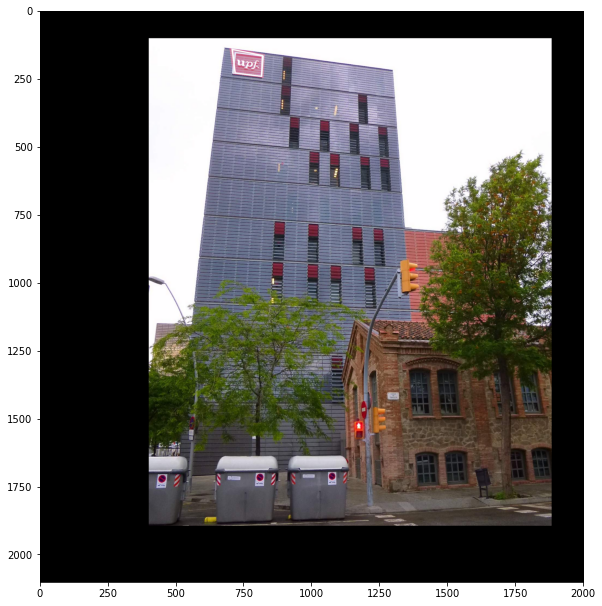

In [354]:
img1, img_logo_color, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFbuilding.jpg',
                                                                                                 detector='SIFT', visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
Hc1, Hc2, Hc3, Hc4 = detect_logo(img1, img2_color, visualization=False)
replace_logo(H_12, img_logo_color, img2_color)
pass

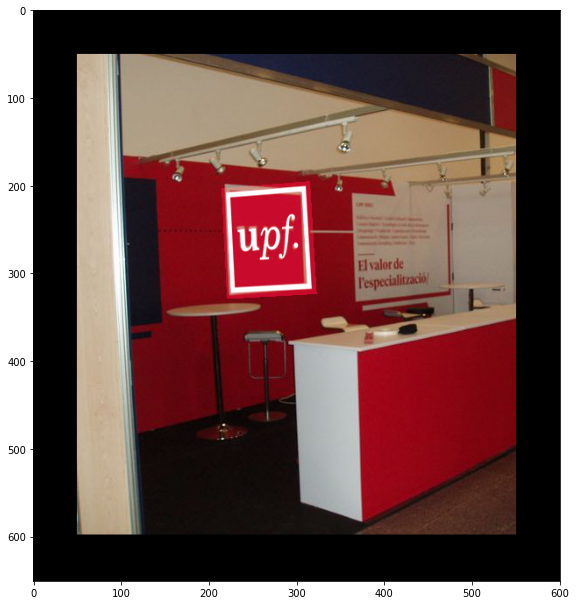

In [345]:
img1, img_logo_color, img2, img2_color, kp1, kp2, good_matches_12 = compute_correspondences_logo('./Data/logos/logoUPF.png', './Data/logos/UPFstand.jpg',
                                                                                                 detector='SIFT', visualization=False)
H_12, points1, points2, indices_inlier_matches_12  = compute_homography(kp1, kp2, good_matches_12, img1, img2, visualization=False)
Hc1, Hc2, Hc3, Hc4 = detect_logo(img1, img2_color, visualization=False)
replace_logo(H_12, img_logo_color, img2_color, corners = [-50, 550, -50, 600])
pass

Logo replacement worked well in both cases